<a href="https://colab.research.google.com/github/CelinaWalkowicz/Wildfire-Predictions/blob/main/Wildfires.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#[Predicting Wildfire Burn Area with Weather Forecast Data](https://developer.ibm.com/exchanges/data/all/spot-challenge-wildfires/) 

##Directory

1.   Imports, Data Import, and Functions
    *   Imports
    *   Data Import
    *   Functions
2.   EDA and Data Wrangling
    *    EDA 
    *    Data Wrangle 
        *   Historic Weather & Historic Weather Forecasting
        *   Historic Wildfires
        *   NSW Wildfire Temperatures
        *   Vegetation Index
        *   Land Class
    *   Data Frame Merging
3.   Split Data
4.   Model Building
    *   Establish Baseline Accuracy & MAE
    *   Linear Regression Model
    *   Ridge Regression Model
    *   Random Forest Regression Model
        *   Base Model
        *   Random Search CV
        *   Grid Search CV
    *   XGBoost Model
        *   Model Building
            *   Base Model
            *   Random Search CV
            *   Grid Search CV
    *   Metrics Summary
5. XGBoost Reggresor Model Results
    *   Features Importance
    *   Permutation Importance
    *   Partial Dependance Plots
        *   One Feature Plot: Features Importance
        *   One Feature Plot: Permutation Importance
        *   Two Feature Plot: Iteraction Between Feature Importance and Permutation Importance
    *   Shapley Plot
6.   Visualizations
    *  Models
    *  Features and Permutation Importance
    *  PDP Plots
    *  Shapley Plots



---

To Run Notebook -- From Start:
1. Comment out PDP and Shap in Installs, and Pip Installs
2. Run Cells before "Further EDA..." in "Historic Weather and Date Historic Weather Forecast" in "Data Wrangling"
3. Run cells beginning at "Historic Wilfires" in "Data Wrangle, and stop at "Partial Dependance Plots" in "5. XGBoost Model Results"
4. Run Visualizations, first 3 Cells ***only***
5. Run PDP and Shap Pip Installs
6. Run PDP and Shap Imports
6. Run PDP and Shap Cells
7. Run Visualizations PDP plots, and Shapley Plots ***ONLY***






#1.   Pip Installs, Imports, Data Import, and Functions


##Imports

In [2]:
#General
import pandas as pd
import numpy as np
import timeit
import sys

In [3]:
#Plotting
import matplotlib as plt
import seaborn as sns
import plotly.express as px

In [4]:
#Display Images/HTML
from IPython.display import Image
from IPython.core.display import HTML 

In [ ]:
#Model Building
%%capture 

!pip install category_encoders==2.*

In [153]:
#Pipeline
from sklearn.pipeline import make_pipeline

#Models
from sklearn.linear_model import LinearRegression, Ridge
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import RandomForestRegressor

#Boosted Models
from xgboost import XGBClassifier, XGBRegressor

#Permutation Importance
from sklearn.inspection import permutation_importance 

#Encoders and Hyperparameters
from category_encoders import OneHotEncoder, OrdinalEncoder
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler

#Feature & Hypertuning Selection
from sklearn.model_selection import TimeSeriesSplit, GroupShuffleSplit
from sklearn.model_selection import RepeatedKFold, cross_val_score
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.inspection import permutation_importance
from sklearn.metrics import plot_confusion_matrix, classification_report

#Metric Check
from sklearn.base import BaseEstimator
from sklearn.metrics import r2_score, accuracy_score
from sklearn.metrics import mean_absolute_error, mean_squared_error

In [6]:
from pandas_profiling import ProfileReport

In [174]:
#PDP
from pdpbox.pdp import pdp_isolate, pdp_plot, pdp_interact, pdp_interact_plot

#Shap
import shap

##Pip Installs

In [173]:
#PDP and Shap
!pip install pdpbox
!pip install shap

  Using cached matplotlib-3.1.1-cp37-cp37m-manylinux1_x86_64.whl (13.1 MB)
  Attempting uninstall: matplotlib
    Found existing installation: matplotlib 3.5.1
    Uninstalling matplotlib-3.5.1:
      Successfully uninstalled matplotlib-3.5.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
pandas-profiling 2.7.1 requires matplotlib>=3.2.0, but you have matplotlib 3.1.1 which is incompatible.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


In [10]:
#Pandas Profiling
!pip install pandas-profiling==2.7.1

##Data Import

In [11]:
# mounting your google drive on colab
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [12]:
#Change File Location
%cd /content/gdrive/My Drive/DataSets/IBM_wildfires

/content/gdrive/My Drive/DataSets/IBM_wildfires


In [13]:
#List of Files
!ls

HistoricalWeather.csv		LICENSE.txt
HistoricalWeatherForecasts.csv	NSW_Wildfires_Temperature.csv
Historical_Wildfires.csv	Readme_Docs_Wildfires-Datasets_2020-11.pdf
LandClass.csv			VegetationIndex.csv


In [14]:
# Create File Path Names
filepath_historic_weather = 'HistoricalWeather.csv'
filepath_historic_weather_forecast = 'HistoricalWeatherForecasts.csv'
filepath_historic_wildfires = 'Historical_Wildfires.csv'
filepath_NSW_wildfires_temps = 'NSW_Wildfires_Temperature.csv'
filepath_vegetation_index = 'VegetationIndex.csv'
filepath_land_class = 'LandClass.csv'

In [15]:
#Read in each CSV
historic_weather = pd.read_csv(filepath_historic_weather,
                               parse_dates=['Date'],
                               index_col='Date')
historic_weather_forecast = pd.read_csv(filepath_historic_weather_forecast,
                                        parse_dates=['Date'],
                                        index_col='Date')
historic_wildfires = pd.read_csv(filepath_historic_wildfires,
                                 parse_dates=['Date'],
                                        index_col='Date')
NSW_wildfires_temps = pd.read_csv(filepath_NSW_wildfires_temps,
                                  parse_dates=['Date_x', 'Date_y'])
vegetation_index = pd.read_csv(filepath_vegetation_index,
                               parse_dates=['Date'],
                               index_col='Date')
land_class = pd.read_csv(filepath_land_class)

##Functions

###General

In [16]:
def newdf_oldcols(df, *cols):
  ### This function returns a New Data Frame with Columns from an Existing Data Frame ###
  new_df = df.loc[:, cols]
  return new_df

In [17]:
def fill_col_nans(df, col, how):
  ### This function fills a column's NaN values ###
  ### For Mean Enter 'mean' in how; For Median etner 'median' in how ###

  #If - Elif Statement to determine HOW
  if how == 'mean':
    #Find Column Mean & Fill NaN values
    col_mean = df[col].mean()
    df[col].fillna(value=col_mean, inplace=True)
    return df

  elif how == 'median':
    #Find Column Median & Fill NaN values
    col_median = df[col].median()
    df[col].fillna(value=col_median, inplace=True)
    return df

  else:
    #Print Exlpanation of HOW
    print("You must enter 'mean' or 'median' for how")


In [18]:
def fahrenheit_to_celsius_converter(fahrenheit):
  ### This function convers temperatures in fahrenheit to celsius ###
  celsius = (fahrenheit - 32) * (5/9)
  return celsius

###Split Data

In [19]:
def train_test_val_drop_comask(df, target, cutoff_test, cutoff_val):
  ## This function splits a data set into X and y Training, Test, and Validation Sets ##
  
  #Set X and y
  y=df[target]
  X=df.drop(columns=target)
  
  #Set Cut Offs
  cutoff_test = cutoff_test
  cutoff_val = cutoff_val
  
  #Set Test Mask
  mask_test = X.index < cutoff_test

  #Create Train Test Sets
  X_train_def, y_train_def = X.loc[mask_test], y.loc[mask_test]
  X_test, y_test = X.loc[~mask_test], y.loc[~mask_test]
    
  #Set Validation Mask
  mask_val = X_train_def.index < cutoff_val

  #Create Train Validation Sets
  X_train, y_train = X_train_def.loc[mask_val], y_train_def.loc[mask_val]
  X_val, y_val = X_train_def.loc[~mask_val], y_train_def.loc[~mask_val]

  return X_train, X_test, X_val, y_train, y_test, y_val

In [20]:
def train_test_val_validation(X_train, y_train, X_val, y_val, X_test, y_test):
  print(f'''
Training Set
X_train Range: {X_train.index.min()} to {X_train.index.max()}
X_train Shape: {X_train.shape}
y_train Range: {y_train.index.min()} to {y_train.index.max()}
y_train Shape: {y_train.shape}

---

Validation Set
X_val Range: {X_val.index.min()} to {X_val.index.max()}
X_val Shape: {X_val.shape}
y_val Range: {y_val.index.min()} to {y_val.index.max()}
y_val Shape: {y_val.shape}

---

Test Set
X_test Range: {X_test.index.min()} to {X_test.index.max()}
X_test Shape: {X_test.shape}
y_test Range: {y_test.index.min()} to {y_test.index.max()}
y_test Shape: {y_test.shape}

---

Sum of Splits Length: {len(y_train) + len(y_val) + len(y_test)}
Data Frane Length: {len(NSW_wildfires)}
Splits and Data Frame have the same length? {
    (len(y_train) + len(y_val) + len(y_test)) == len(NSW_wildfires)}

''') 

###Metric Calculations and Checks

In [21]:
def calc_baseline_mae(y_train):
  ### This function returns a Baseline Mean Absolute Error (Mean of y_train) ###
  
  y_pred = [y_train.mean()] * len(y_train)                                        #Mean Equation

  baseline_mae = mean_absolute_error(y_train, y_pred)                             #MAE Calculation
  
  print(f'''
  Baseline MAE: {baseline_mae}                                                   
  ''')

  return baseline_mae       

In [22]:
def calc_model_mae(model_name, model, X_train, y_train, X_val, y_val):
  ### This function returns the Mean Absolute Error of a Model ###

  #Calculations
  train_mae = mean_absolute_error(y_train, model.predict(X_train))
  val_mae = mean_absolute_error(y_val, model.predict(X_val))

  print(f'''
  {model_name} Training MAE:  {train_mae}
  {model_name} Validation MAE:  {val_mae}  
  ''')

  return train_mae, val_mae

In [23]:
def baseline_accuracy(y_train):
  ### This function calculates a baseline accuracy ###
  base_acc = y_train.value_counts(normalize=True).max()                           #Equation

  print(f'Baseline Accuracy: {base_acc}')

  return base_acc

In [24]:
def acc_score_trainval(model_name, model, X_train, y_train, X_val, y_val):
  ###This function returns the accuracy score of a model for the ###
  ### Train and Validation sets ###

  #Calculations
  train_score = accuracy_score(y_train, model.predict(X_train))
  val_score = accuracy_score(y_val, model.predict(X_val))
  
  print(f'''
  {model_name} Training Accuracy:  {train_score}
  {model_name} Validation Accuracy:  {val_score}  
  ''')

  return train_score, val_score

In [25]:
def calc_model_score(model_name, model, X_train, y_train, X_val, y_val):
  ###This function returns the training and validation scores of a model###

  train_score = model.score(X_train, y_train)
  val_score = model.score(X_val, y_val)

  print(f'''
  {model_name} Training Accuracy:  {train_score}
  {model_name} Validation Accuracy:  {val_score}  
  ''')

  return train_score, val_score

#2.   EDA and Data Wrangling

##EDA

###Pandas Profiling

####Historic Weather

In [26]:
print(f'Shape: {historic_weather.shape}')
historic_weather.head()

Shape: (246141, 7)


,Region,Parameter,count()[unit: km^2],min(),max(),mean(),variance()
Date,,,,,,,
2005-01-01,NSW,Precipitation,800234.348986,0.000000,1.836935,0.044274,0.028362
2005-01-01,NSW,RelativeHumidity,800234.348986,13.877194,80.522964,36.355567,253.559937
2005-01-01,NSW,SoilWaterContent,800234.348986,0.002245,0.414305,0.170931,0.007758
2005-01-01,NSW,SolarRadiation,800234.348986,14.515009,32.169781,26.749389,6.078587
2005-01-01,NSW,Temperature,800234.348986,14.485785,35.878704,27.341182,18.562212


In [27]:
hw_profile = ProfileReport(historic_weather)
hw_profile

Summarize dataset:   0%|          | 0/20 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

####Historic Weather Forecasting

In [28]:
print(f'Shape: {historic_weather_forecast.shape}')
historic_weather_forecast.head()

Shape: (227663, 8)


,Region,Parameter,Lead time,count()[unit: km^2],min(),max(),mean(),variance()
Date,,,,,,,,
2014-01-01,NSW,RelativeHumidity,5,8.037682e+05,7.482927,85.021118,28.223569,353.620815
2014-01-01,NSW,SolarRadiation,5,8.037682e+05,24.865765,33.557598,31.647308,2.276068
2014-01-01,NSW,Temperature,5,8.037682e+05,21.243755,36.929035,30.893523,17.918553
2014-01-01,NSW,WindSpeed,5,8.037682e+05,1.593531,6.989559,3.958822,1.334834
2014-01-01,NT,RelativeHumidity,5,1.349817e+06,14.796251,73.601479,39.799856,189.805002


In [29]:
hwf_profile = ProfileReport(historic_weather_forecast)
hwf_profile

Summarize dataset:   0%|          | 0/21 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

####Historic Wildfires

In [30]:
print(f'Shape: {historic_wildfires.shape}')
historic_wildfires.head()

Shape: (26739, 9)


,Region,Estimated_fire_area,Mean_estimated_fire_brightness,Mean_estimated_fire_radiative_power,Mean_confidence,Std_confidence,Var_confidence,Count,Replaced
Date,,,,,,,,,
2005-01-04,NSW,8.68000,312.266667,42.400000,78.666667,2.886751,8.333333,3,R
2005-01-05,NSW,16.61125,322.475000,62.362500,85.500000,8.088793,65.428571,8,R
2005-01-06,NSW,5.52000,325.266667,38.400000,78.333333,3.214550,10.333333,3,R
2005-01-07,NSW,6.26400,313.870000,33.800000,92.200000,7.529940,56.700000,5,R
2005-01-08,NSW,5.40000,337.383333,122.533333,91.000000,7.937254,63.000000,3,R


In [31]:
hf_profile = ProfileReport(historic_wildfires)
hf_profile

Summarize dataset:   0%|          | 0/22 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

####NSW Wildfire Temperatures

In [32]:
print(f'Shape: {NSW_wildfires_temps.shape}')
NSW_wildfires_temps.head()

Shape: (4538, 19)


,Region_x,Date_x,Estimated_fire_area,Mean_estimated_fire_brightness,Mean_estimated_fire_radiative_power,Mean_confidence,Std_confidence,Var_confidence,Count,Replaced,DateTime,Date_y,Region_y,Parameter,count()[unit: km^2],min(),max(),mean(),2nd moment
0,NSW,2005-01-04,26.04,312.266667,42.400000,78.666667,2.886751,8.333333,3,R,2005-01-04,2005-01-04,NSW,Temperature,800234.348986,12.495799,28.945488,23.055527,541.012822
1,NSW,2005-01-05,132.89,322.475000,62.362500,85.500000,8.088793,65.428571,8,R,2005-01-05,2005-01-05,NSW,Temperature,800234.348986,9.611800,29.510120,22.425765,516.267308
2,NSW,2005-01-06,16.56,325.266667,38.400000,78.333333,3.214550,10.333333,3,R,2005-01-06,2005-01-06,NSW,Temperature,800234.348986,9.024039,26.982698,20.621405,437.006517
3,NSW,2005-01-07,31.32,313.870000,33.800000,92.200000,7.529940,56.700000,5,R,2005-01-07,2005-01-07,NSW,Temperature,800234.348986,8.691216,24.752069,19.632722,393.384139
4,NSW,2005-01-08,16.20,337.383333,122.533333,91.000000,7.937254,63.000000,3,R,2005-01-08,2005-01-08,NSW,Temperature,800234.348986,10.821342,26.472469,21.477315,473.339043


In [33]:
NSW_wt_profile = ProfileReport(NSW_wildfires_temps)
NSW_wt_profile

Summarize dataset:   0%|          | 0/31 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

####Vegetation Index

In [34]:
vegetation_index.head()

,Region,Vegetation_index_mean,Vegetation_index_max,Vegetation_index_min,Vegetation_index_std,Vegetation_index_variance
Date,,,,,,
2005-01-01,NSW,0.349202,0.9972,-0.2,0.204862,0.041968
2005-02-01,NSW,0.357403,0.9772,-0.2,0.208673,0.043544
2005-03-01,NSW,0.354087,0.9750,-0.2,0.209450,0.043869
2005-04-01,NSW,0.347242,0.9904,-0.2,0.207307,0.042976
2005-05-01,NSW,0.345526,0.9972,-0.2,0.202858,0.041151


In [35]:
veg_profile = ProfileReport(vegetation_index)
veg_profile

Summarize dataset:   0%|          | 0/19 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

####Land Class

In [36]:
print(f'Shape: {land_class.shape}')
land_class.head(10)

Shape: (7, 15)


,Region,Shrubs,Herbaceous vegetation,Cultivated and managed vegetation/agriculture (cropland),Urban / built up,Bare / sparse vegetation,Permanent water bodies,Herbaceous wetland,"Closed forest, evergreen, broad leaf","Closed forest, deciduous broad leaf","Closed forest, unknown","Open forest, evergreen broad leaf","Open forest, deciduous broad leaf","Open forest, unknown definitions",Open sea
0,NSW,6.2,43.6,13.0,0.3,0.2,0.2,0.1,14.7,6.8,0.3,0.5,3.7,10.3,0.1
1,NT,18.1,48.9,0.1,0.0,0.4,0.1,0.1,1.0,7.7,0.1,0.1,13.6,9.3,0.5
2,QL,9.5,45.3,1.6,0.1,1.1,0.1,0.0,5.3,13.3,0.3,0.1,12.0,11.0,0.3
3,SA,24.1,54.8,5.8,0.1,4.8,1.2,0.1,0.3,1.3,0.1,0.1,1.4,5.3,0.6
4,TA,0.7,23.8,1.2,0.2,0.1,1.9,1.4,50.1,0.6,1.1,7.2,1.5,7.2,3.0
5,WA,31.3,43.5,5.6,0.0,1.0,0.4,0.0,1.2,2.4,0.2,0.1,4.8,8.7,0.8
6,VI,1.4,35.0,23.3,1.0,0.1,0.6,0.3,23.9,3.8,0.3,1.5,2.7,5.2,0.9


In [37]:
lc_profile = ProfileReport(land_class)
lc_profile

Summarize dataset:   0%|          | 0/27 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### Additional EDA

In [38]:
print(f'''
Historic Weather Forecast

Regions:
{historic_weather_forecast['Region'].value_counts()}

Parameters:
Unique Parameters: {historic_weather_forecast['Parameter'].nunique()}
{historic_weather_forecast['Parameter'].value_counts().sort_index(ascending=True)}

Date Minimum & Maximum (Respectively): 
{historic_weather_forecast.index.min()}, {historic_weather_forecast.index.max()}
''')


Historic Weather Forecast

Regions:
WA     32525
NT     32525
QL     32525
NSW    32522
SA     32522
TA     32522
VI     32522
Name: Region, dtype: int64

Parameters:
Unique Parameters: 5
Precipitation       42042
RelativeHumidity    46427
SolarRadiation      46378
Temperature         46431
WindSpeed           46385
Name: Parameter, dtype: int64

Date Minimum & Maximum (Respectively): 
2014-01-01 00:00:00, 2021-02-14 00:00:00



In [39]:
print(f'''
Historic Weather

Value Counts:
{historic_weather['Region'].value_counts()}

Parameters:
Unique Parameters: {historic_weather['Parameter'].nunique()}
{historic_weather['Parameter'].value_counts().sort_index(ascending=True)}

Date Minimum & Maximum (Respectively): 
{historic_weather.index.min()}, {historic_weather.index.max()}
''')


Historic Weather

Value Counts:
WA     35163
NSW    35163
NT     35163
QL     35163
SA     35163
TA     35163
VI     35163
Name: Region, dtype: int64

Parameters:
Unique Parameters: 6
Precipitation       41034
RelativeHumidity    40999
SoilWaterContent    41041
SolarRadiation      41027
Temperature         41027
WindSpeed           41013
Name: Parameter, dtype: int64

Date Minimum & Maximum (Respectively): 
2005-01-01 00:00:00, 2021-01-23 00:00:00



In [40]:
print(f'''
Vegetation Index

Regions:
{vegetation_index['Region'].value_counts()}

Date Minimum & Maximum (Respectively): 
{vegetation_index.index.min()}, {vegetation_index.index.max()}
''')


Vegetation Index

Regions:
TA     193
QL     193
NSW    193
SA     193
NT     193
VI     193
WA     193
Name: Region, dtype: int64

Date Minimum & Maximum (Respectively): 
2005-01-01 00:00:00, 2021-01-01 00:00:00



In [41]:
print(f'''
Historic Wildfires

Regions:
{historic_wildfires['Region'].value_counts()}

Date:
{historic_wildfires.index.value_counts().head(25)}

Date Minimum & Maximum (Respectively): 
{historic_wildfires.index.min()}, {historic_wildfires.index.max()}
''')


Historic Wildfires

Regions:
WA     5713
QL     5620
NT     5103
NSW    4672
VI     2192
SA     2018
TA     1421
Name: Region, dtype: int64

Date:
2012-04-18    7
2016-04-18    7
2006-03-09    7
2005-03-29    7
2008-04-29    7
2013-03-26    7
2008-04-21    7
2005-04-01    7
2009-05-04    7
2016-04-17    7
2019-01-30    7
2019-03-15    7
2007-05-13    7
2012-04-03    7
2009-04-07    7
2007-04-11    7
2014-04-17    7
2019-04-24    7
2010-03-24    7
2009-03-26    7
2014-04-07    7
2008-04-09    7
2010-05-14    7
2006-12-10    7
2013-01-04    7
Name: Date, dtype: int64

Date Minimum & Maximum (Respectively): 
2005-01-01 00:00:00, 2021-01-29 00:00:00



In [42]:
NSW_wildfires_temps['Date_x'].equals(NSW_wildfires_temps['Date_y'])

False

In [43]:
NSW_wildfires_temps['DateTime'].equals(NSW_wildfires_temps['Date_y'])

False

In [44]:
NSW_wildfires_temps.loc[NSW_wildfires_temps['2nd moment'] <= 28] 

,Region_x,Date_x,Estimated_fire_area,Mean_estimated_fire_brightness,Mean_estimated_fire_radiative_power,Mean_confidence,Std_confidence,Var_confidence,Count,Replaced,DateTime,Date_y,Region_y,Parameter,count()[unit: km^2],min(),max(),mean(),2nd moment
759,NSW,2007-07-18,164.28,312.044444,88.322222,88.777778,10.568559,111.694444,9,R,2007-07-18,2007-07-18,NSW,Temperature,800234.348986,-2.181178,11.942973,4.804636,26.957176


In [45]:
print(f'''
NSW Wildfire Temperature Dates

Total Values: {NSW_wildfires_temps.shape[0]}

DateTime: 
Unique Values: {NSW_wildfires_temps['DateTime'].nunique()}
{NSW_wildfires_temps['DateTime'].value_counts().head().sort_index(ascending=True)}

Date_x:
Unique Values: {NSW_wildfires_temps['Date_x'].nunique()}
{NSW_wildfires_temps['Date_x'].value_counts().head().sort_index(ascending=True)}

Date_y:
Unique Values: {NSW_wildfires_temps['Date_y'].nunique()}
{NSW_wildfires_temps['Date_y'].value_counts().head().sort_index(ascending=True)}
''')


NSW Wildfire Temperature Dates

Total Values: 4538

DateTime: 
Unique Values: 4538
2005-10-25    1
2013-11-05    1
2016-07-31    1
2017-01-09    1
2017-12-29    1
Name: DateTime, dtype: int64

Date_x:
Unique Values: 4538
2006-04-17    1
2007-09-10    1
2015-09-21    1
2016-11-22    1
2018-03-17    1
Name: Date_x, dtype: int64

Date_y:
Unique Values: 4536
2006-04-17    1
2007-09-10    1
2015-01-21    1
2018-03-17    1
2019-02-28    1
Name: Date_y, dtype: int64



In [46]:
NSW_wildfires_temps.isnull().sum()

Region_x                                 0
Date_x                                   0
Estimated_fire_area                      0
Mean_estimated_fire_brightness           0
Mean_estimated_fire_radiative_power      0
Mean_confidence                          0
Std_confidence                         539
Var_confidence                         539
Count                                    0
Replaced                                 0
DateTime                                 0
Date_y                                   2
Region_y                                 2
Parameter                                2
count()[unit: km^2]                      2
min()                                    2
max()                                    2
mean()                                   2
2nd moment                               2
dtype: int64

In [47]:
NSW_wildfires_temps['Parameter'].value_counts()

Temperature    4536
Name: Parameter, dtype: int64

In [48]:
historic_wildfires.columns

Index(['Region', 'Estimated_fire_area', 'Mean_estimated_fire_brightness',
       'Mean_estimated_fire_radiative_power', 'Mean_confidence',
       'Std_confidence', 'Var_confidence', 'Count', 'Replaced'],
      dtype='object')

In [49]:
print(f'''
Min Fire Area: {historic_wildfires['Estimated_fire_area'].min()}
Max Fire Area: {historic_wildfires['Estimated_fire_area'].max()}
''')


Min Fire Area: 1.0
Max Fire Area: 10120.94317



##Data Wrangle of Individual Data Frames

###Historic Weather & Historic Weather Forecast

In [50]:
def wrangle_weather(filepath):
  ### This function wrangles both weather data sets ###

  #Read Data
  df = pd.read_csv(filepath,
                parse_dates=['Date'],
                index_col='Date',
                skipinitialspace=True
                )
  
  #Reduce Scope of the Data
    #Only Data from 2014 and after
  df = df[df.index.year >= 2014]
  df = df[df.index <= '2021-01-23']
    #NSW Region
  df = df[df['Region'] == 'NSW']
    #Reduce to neccessary columns only
  df = df[['Parameter', 'mean()']]

  # #Create Parameter Columns
    #Duplicate Index Troublshooting Pt 1
  df.reset_index(inplace=True)
    #Precipitation
  df['Precipitation'] = df.loc[df['Parameter'] == 
                               'Precipitation', 'mean()']
    #Relative Humidity
  df['Relative_Humidity'] = (df.loc[df['Parameter'] == 
                                    'RelativeHumidity', 'mean()'])
    #Solar Radiation
  df['Solar_Radiation'] = df.loc[df['Parameter'] == 
                                 'SolarRadiation', 'mean()']
    #Temperature
  df['Temperature'] = df.loc[df['Parameter'] == 'Temperature', 'mean()']

    #Wind Speed
  df['Wind_Speed'] = df.loc[df['Parameter'] == 
                            'WindSpeed', 'mean()']
    #Soil Water Content
  if filepath == filepath_historic_weather:
    df['Soil_Water_Content'] = df.loc[df['Parameter'] == 
                                      'SoilWaterContent', 'mean()']
    #Drop Origin Columns
  df.drop(columns=['Parameter', 'mean()'], inplace=True)
    #Duplicate Index Troubleshooting Pt2
  df.set_index('Date', inplace=True)
  df = df.groupby(level=0).sum()

  #Append Column Names
  if filepath == filepath_historic_weather:
    df = df.add_suffix('_actual')
  elif filepath == filepath_historic_weather_forecast:
    df = df.add_suffix('_forecast')
  else:
    print(
'Filepath must be "filepath_historic_weather" or "filepath_historic_weather_forecast"'
)

  #Fix Column Names
  df.columns = [x.lower() for x in df.columns]
    
  return df

In [51]:
hw = wrangle_weather(filepath_historic_weather)

In [52]:
hwf = wrangle_weather(filepath_historic_weather_forecast)

#Convert Historic Weather Forecast Temperatures to Celsius 
#Could not apply function inside wrangle, without the calculations 
#returning inaccurately
hwf['temperature_forecast'] = hwf['temperature_forecast'].apply(fahrenheit_to_celsius_converter)

In [53]:
print(f'''
Shape: {hw.shape}
Min: {hw.index.min()}
Max: {hw.index.max()}
''')
hw.head()


Shape: (2576, 6)
Min: 2014-01-01 00:00:00
Max: 2021-01-23 00:00:00



,precipitation_actual,relative_humidity_actual,solar_radiation_actual,temperature_actual,wind_speed_actual,soil_water_content_actual
Date,,,,,,
2014-01-01,0.265846,29.406773,25.359682,29.204838,3.315765,0.158274
2014-01-02,0.336884,38.744250,24.123158,29.259400,3.813317,0.159515
2014-01-03,0.073854,39.524400,28.829655,27.243161,5.876960,0.158068
2014-01-04,0.203949,36.911058,32.490868,21.937499,3.403316,0.158421
2014-01-05,0.026990,33.399606,32.537030,24.005203,4.769847,0.156968


In [54]:
print(f'''
Shape: {hwf.shape}
Min: {hwf.index.min()}
Max: {hwf.index.max()}
''')
hwf.head()


Shape: (2559, 5)
Min: 2014-01-01 00:00:00
Max: 2021-01-23 00:00:00



,precipitation_forecast,relative_humidity_forecast,solar_radiation_forecast,temperature_forecast,wind_speed_forecast
Date,,,,,
2014-01-01,0.0,28.223569,31.647308,-0.614709,3.958822
2014-01-02,0.0,41.854657,24.991813,-0.585764,5.116995
2014-01-03,0.0,40.073863,24.660504,-1.811094,5.696997
2014-01-04,0.0,40.334391,32.975682,-4.659267,4.260682
2014-01-05,0.0,39.400439,32.435075,-5.007908,3.967104


#### Further EDA for Historic Weather and Historic Weather Forecast

In [62]:
#Final Check After Function Application Outside Wrangle
print(f'''
Historic Weather
{hw['temperature_actual'].min()}
{hw['temperature_actual'].max()}

Historic Weather Forecast
{hwf['temperature_forecast'].min()}
{hwf['temperature_forecast'].max()}
''')


Historic Weather
0.0
34.63907866585903

Historic Weather Forecast
-17.77777777777778
38.73131463648997



#####EDA Testing

In [55]:
#Check for same unit of measurement; 
#furhter work indicates one may be in C and the other in F

#Create Copies of Data Frame
hw_check = hw.copy()
hwf_check = hwf.copy()

print(f'''
Historic Weather
{hw_check['temperature_actual'].min()}
{hw_check['temperature_actual'].max()}

Historic Weather Forecast
{hwf_check['temperature_forecast'].min()}
{hwf_check['temperature_forecast'].max()}
''')


Historic Weather
0.0
34.63907866585903

Historic Weather Forecast
0.0
101.71636634568195



In [56]:
print(f'''
{fahrenheit_to_celsius_converter(hwf_check['temperature_forecast'].min())}
{fahrenheit_to_celsius_converter(hwf_check['temperature_forecast'].max())}
''')


-17.77777777777778
38.73131463648997



In [57]:
#Check Converter Worked

#Create Copies of Data Frame
hw_check2 = hw.copy()
hwf_check2 = hwf.copy()

hwf_check2['temperature_forecast'] = hwf_check2['temperature_forecast'].apply(fahrenheit_to_celsius_converter)

print(f'''
Historic Weather
{hw_check2['temperature_actual'].min()}
{hw_check2['temperature_actual'].max()}

Historic Weather Forecast
{hwf_check2['temperature_forecast'].min()}
{hwf_check2['temperature_forecast'].max()}
''')


Historic Weather
0.0
34.63907866585903

Historic Weather Forecast
-17.77777777777778
38.73131463648997



In [58]:
hwf_check['temperature_forecast']

Date
2014-01-01    30.893523
2014-01-02    30.945624
2014-01-03    28.740031
2014-01-04    23.613320
2014-01-05    22.985766
                ...    
2021-01-19    67.063239
2021-01-20    72.455817
2021-01-21    78.819685
2021-01-22    78.714600
2021-01-23    76.362838
Name: temperature_forecast, Length: 2559, dtype: float64

In [59]:
hwf_check2['temperature_forecast']

Date
2014-01-01    -0.614709
2014-01-02    -0.585764
2014-01-03    -1.811094
2014-01-04    -4.659267
2014-01-05    -5.007908
                ...    
2021-01-19    19.479577
2021-01-20    22.475454
2021-01-21    26.010936
2021-01-22    25.952556
2021-01-23    24.646021
Name: temperature_forecast, Length: 2559, dtype: float64

###Historic Wildfires

In [85]:
def hist_wf(filepath):
  ### This function wrangles both weather data sets ###

  #Read Data
  df = pd.read_csv(filepath,
                parse_dates=['Date'],
                index_col='Date',
                skipinitialspace=True
                )
  
  #Reduce Scope of the Data
    #Only Data from 2014 and after
  df = df[df.index.year >= 2014]
  df = df[df.index <= '2021-01-23']
    #NSW Region
  df = df[df['Region'] == 'NSW']
  df.drop(columns='Region', inplace=True)
    #Remove Constants, and redundant columns
  df.drop(columns=['Count', 'Replaced'], inplace=True)

  #Boolean Column: 1 Indicating a Fire Occured
  df['Fire_Occurrence'] = (df['Estimated_fire_area'] > 0).astype(int)


  #Fix Column Names
  df.columns = [x.lower() for x in df.columns]

  return df

In [86]:
wildfires = hist_wf(filepath_historic_wildfires)

In [87]:
wildfires.head()

,estimated_fire_area,mean_estimated_fire_brightness,mean_estimated_fire_radiative_power,mean_confidence,std_confidence,var_confidence,fire_occurrence
Date,,,,,,,
2014-01-01,3.000000,321.216667,49.966667,91.000000,9.000000,81.000000,1
2014-01-03,74.017209,320.410465,70.576744,93.720930,7.935231,62.967885,1
2014-01-04,102.937500,318.631250,119.006250,88.750000,7.812315,61.032258,1
2014-01-05,85.902143,322.239286,63.289286,91.910714,8.334543,69.464610,1
2014-01-06,145.659508,319.965574,108.895082,91.426230,7.497686,56.215301,1


### Wildfire Temps

In [88]:
def wild_temps(filepath):
  
  #Read In
  df = pd.read_csv(filepath,
                   parse_dates=['Date_x', 'Date_y'])
  
  #Reduce Scope
  # df = df[df[]]
  
  #Drop Constants
  df.drop(columns=['Region_x', 'Region_y', 'Replaced', 
                   'count()[unit: km^2]', 'Parameter'
                   ], inplace=True)

  #Fix Column Names
  df.columns = df.columns.str.lower().str.replace(',', '').str.replace(' ', '_')
  
  return df

In [89]:
wildfire_temps = wild_temps(filepath_NSW_wildfires_temps)

In [90]:
wildfire_temps.head()

,date_x,estimated_fire_area,mean_estimated_fire_brightness,mean_estimated_fire_radiative_power,mean_confidence,std_confidence,var_confidence,count,datetime,date_y,min(),max(),mean(),2nd_moment
0,2005-01-04,26.04,312.266667,42.400000,78.666667,2.886751,8.333333,3,2005-01-04,2005-01-04,12.495799,28.945488,23.055527,541.012822
1,2005-01-05,132.89,322.475000,62.362500,85.500000,8.088793,65.428571,8,2005-01-05,2005-01-05,9.611800,29.510120,22.425765,516.267308
2,2005-01-06,16.56,325.266667,38.400000,78.333333,3.214550,10.333333,3,2005-01-06,2005-01-06,9.024039,26.982698,20.621405,437.006517
3,2005-01-07,31.32,313.870000,33.800000,92.200000,7.529940,56.700000,5,2005-01-07,2005-01-07,8.691216,24.752069,19.632722,393.384139
4,2005-01-08,16.20,337.383333,122.533333,91.000000,7.937254,63.000000,3,2005-01-08,2005-01-08,10.821342,26.472469,21.477315,473.339043


###Vegetation Index

In [91]:
def veg_idx(filepath):
  ### This function wrangles both weather data sets ###

  #Read Data
  df = pd.read_csv(filepath,
                parse_dates=['Date'],
                index_col='Date',
                skipinitialspace=True
                )
  
  #Reduce Scope of the Data
    #Only Data from 2014 and after
  df = df[df.index.year >= 2014]
    #NSW Region
  df = df[df['Region'] == 'NSW']
  df.drop(columns='Region', inplace=True)

  #Fix Column Names
  df.columns = [x.lower() for x in df.columns]
    
  return df

In [92]:
vegetation_idx = veg_idx(filepath_vegetation_index)

In [93]:
vegetation_idx.head()

,vegetation_index_mean,vegetation_index_max,vegetation_index_min,vegetation_index_std,vegetation_index_variance
Date,,,,,
2014-01-01,0.320179,0.9955,-0.2,0.178057,0.031704
2014-02-01,0.333173,0.9761,-0.2,0.179729,0.032303
2014-03-01,0.412400,0.9782,-0.2,0.202383,0.040959
2014-04-01,0.487626,0.9914,-0.2,0.210596,0.044351
2014-05-01,0.495689,0.9795,-0.2,0.201446,0.040580


###Land Class

In [94]:
def lc_wrangle(filepath):
  ### This function wrangles both weather data sets ###

  #Read Data
  df = pd.read_csv(filepath,
                skipinitialspace=True
                )
  
  #Reduce Scope of Data
  df = df[df['Region'] == 'NSW']
  
  #Create Columns for Forest Types

     #Master List
  land_class_cols = df.columns.to_list()
  
    #Function for Sub Lists
  def grouping(master_list, keyword):
    ### This function returns a list of elements ###
    ### containing a keyword from another list ###
    return [x for x in master_list if keyword in x]

    #total open forest
  total_open = grouping(land_class_cols, 'Open')
  df['total_open_forest'] = df[total_open].sum(axis=1)
    #total closed forest
  total_closed = grouping(land_class_cols, 'Closed')
  df['total_closed_forest'] = df[total_closed].sum(axis=1)
    #Total Forest
  total_forest = total_open + total_closed
  df['total_forest'] = df[total_forest].sum(axis=1)

  #Fix Column Names
  df.rename(columns={
      'Cultivated and managed vegetation/agriculture (cropland)': 'Cropland',
  }, inplace=True)
  df.columns = df.columns.str.lower().str.replace(',', '').str.replace(' ', '_')

  return df.melt()

In [95]:
NSW_land_class = lc_wrangle(filepath_land_class)

In [96]:
NSW_land_class.head(25)

,variable,value
0,region,NSW
1,shrubs,6.2
2,herbaceous_vegetation,43.6
3,cropland,13
4,urban_/_built_up,0.3
5,bare_/_sparse_vegetation,0.2
6,permanent_water_bodies,0.2
7,herbaceous_wetland,0.1
8,closed_forest_evergreen_broad_leaf,14.7
9,closed_forest_deciduous_broad_leaf,6.8


##Data Frame Merging

Wrangle To-Do for Merge:
*   ~~Boolean Yes/No There was a Fire~~
*   ~~Forecast Weather Params~~
*   ~~Actual Weather Params~~


In [97]:
#Create New Data Frame
  #Create DF of NSW fire occurences
NSW_wildfire_occurrence = newdf_oldcols(wildfires, 'estimated_fire_area', 'fire_occurrence')

  #Create NSW Wildfires DataFrame of Occurrences, Actual Historic Weather, 
  #and Historic Forecasted Weather
NSW_wildfires = hwf.join(hw, how='outer')
NSW_wildfires = NSW_wildfires.join(NSW_wildfire_occurrence, how='left')
  
  #Round all Data Points to 5 places
NSW_wildfires = NSW_wildfires.round(5)

  #Fill Estimated Fire Area NaNs with 0s indicating there was no fire
NSW_wildfires['estimated_fire_area'].fillna(0, inplace=True)

  #Fill Fire Occurence NaNs with 0s indicating there was no fire
NSW_wildfires['fire_occurrence'].fillna(0, inplace=True)
NSW_wildfires = NSW_wildfires.astype({'fire_occurrence':int})

In [98]:
print(f'Shape: {NSW_wildfires.shape}')
NSW_wildfires.head()

Shape: (2580, 13)


,precipitation_forecast,relative_humidity_forecast,solar_radiation_forecast,temperature_forecast,wind_speed_forecast,precipitation_actual,relative_humidity_actual,solar_radiation_actual,temperature_actual,wind_speed_actual,soil_water_content_actual,estimated_fire_area,fire_occurrence
Date,,,,,,,,,,,,,
2014-01-01,0.0,28.22357,31.64731,-0.61471,3.95882,0.26585,29.40677,25.35968,29.20484,3.31576,0.15827,3.00000,1
2014-01-02,0.0,41.85466,24.99181,-0.58576,5.11699,0.33688,38.74425,24.12316,29.25940,3.81332,0.15952,0.00000,0
2014-01-03,0.0,40.07386,24.66050,-1.81109,5.69700,0.07385,39.52440,28.82965,27.24316,5.87696,0.15807,74.01721,1
2014-01-04,0.0,40.33439,32.97568,-4.65927,4.26068,0.20395,36.91106,32.49087,21.93750,3.40332,0.15842,102.93750,1
2014-01-05,0.0,39.40044,32.43508,-5.00791,3.96710,0.02699,33.39961,32.53703,24.00520,4.76985,0.15697,85.90214,1


In [99]:
NSW_wildfires.isnull().sum()

precipitation_forecast        21
relative_humidity_forecast    21
solar_radiation_forecast      21
temperature_forecast          21
wind_speed_forecast           21
precipitation_actual           4
relative_humidity_actual       4
solar_radiation_actual         4
temperature_actual             4
wind_speed_actual              4
soil_water_content_actual      4
estimated_fire_area            0
fire_occurrence                0
dtype: int64

In [100]:
NSW_wildfires['fire_occurrence'].value_counts()

1    2144
0     436
Name: fire_occurrence, dtype: int64

#3   Split Data

In [101]:
print(f'Shape: {NSW_wildfires.shape}')
NSW_wildfires.head()

Shape: (2580, 13)


,precipitation_forecast,relative_humidity_forecast,solar_radiation_forecast,temperature_forecast,wind_speed_forecast,precipitation_actual,relative_humidity_actual,solar_radiation_actual,temperature_actual,wind_speed_actual,soil_water_content_actual,estimated_fire_area,fire_occurrence
Date,,,,,,,,,,,,,
2014-01-01,0.0,28.22357,31.64731,-0.61471,3.95882,0.26585,29.40677,25.35968,29.20484,3.31576,0.15827,3.00000,1
2014-01-02,0.0,41.85466,24.99181,-0.58576,5.11699,0.33688,38.74425,24.12316,29.25940,3.81332,0.15952,0.00000,0
2014-01-03,0.0,40.07386,24.66050,-1.81109,5.69700,0.07385,39.52440,28.82965,27.24316,5.87696,0.15807,74.01721,1
2014-01-04,0.0,40.33439,32.97568,-4.65927,4.26068,0.20395,36.91106,32.49087,21.93750,3.40332,0.15842,102.93750,1
2014-01-05,0.0,39.40044,32.43508,-5.00791,3.96710,0.02699,33.39961,32.53703,24.00520,4.76985,0.15697,85.90214,1


To-Do:
*   Determine Split Locations
*   Split Data
*   Verify Split Accuracy

In [102]:
#Determine Split Locations
print(f'''
Test Split
20% Cutoff = {-len(NSW_wildfires)*.2}
20% Index Date: {NSW_wildfires.index[-516]}

---

Validation Split
20% Cutoff = {(-(NSW_wildfires.shape[0]-(len(NSW_wildfires)*.2))*.2)+-516}
20% Index Date = {NSW_wildfires.index[-928]}
''')


Test Split
20% Cutoff = -516.0
20% Index Date: 2019-08-27 00:00:00

---

Validation Split
20% Cutoff = -928.8
20% Index Date = 2018-07-11 00:00:00



In [103]:
#Assign Target, and CutOffs
target = 'estimated_fire_area'
cutoff_test = '2019-08-27'
cutoff_val = '2018-07-11'

#Assign X, y variables
y = NSW_wildfires[target]
X = NSW_wildfires.drop(columns=target)

#Split Data Using Above Function
X_train, X_test, X_val, y_train, y_test, y_val = (
    train_test_val_drop_comask(NSW_wildfires, target, cutoff_test, cutoff_val)
    )

In [104]:
#Verify Split Accuracy with Above Function
train_test_val_validation(X_train, y_train, X_val, y_val, X_test, y_test)


Training Set
X_train Range: 2014-01-01 00:00:00 to 2018-07-10 00:00:00
X_train Shape: (1652, 12)
y_train Range: 2014-01-01 00:00:00 to 2018-07-10 00:00:00
y_train Shape: (1652,)

---

Validation Set
X_val Range: 2018-07-11 00:00:00 to 2019-08-26 00:00:00
X_val Shape: (412, 12)
y_val Range: 2018-07-11 00:00:00 to 2019-08-26 00:00:00
y_val Shape: (412,)

---

Test Set
X_test Range: 2019-08-27 00:00:00 to 2021-01-23 00:00:00
X_test Shape: (516, 12)
y_test Range: 2019-08-27 00:00:00 to 2021-01-23 00:00:00
y_test Shape: (516,)

---

Sum of Splits Length: 2580
Data Frane Length: 2580
Splits and Data Frame have the same length? True




#4.   Model Building

##Baseline Accuracy & MAE

In [105]:
#Establish a Baseline MAE
baseline_mae = calc_baseline_mae(y_train)


  Baseline MAE: 30.558233634863313                                                   
  


In [106]:
#Establish a Baseline Accuracy
# baseline_accuracy = baseline_accuracy(y_train)                                 ###Function was not working consistently ###
base_acc = y_train.value_counts(normalize=True).max()
print(f'Baseline Accuracy:  {base_acc}')

Baseline Accuracy:  0.1761501210653753


## Linear Regression Model

In [107]:
#Reset Index for Plotting Purposes
plty_NSW_wf = NSW_wildfires.reset_index()

In [108]:
plty_NSW_wf.columns

Index(['Date', 'precipitation_forecast', 'relative_humidity_forecast',
       'solar_radiation_forecast', 'temperature_forecast',
       'wind_speed_forecast', 'precipitation_actual',
       'relative_humidity_actual', 'solar_radiation_actual',
       'temperature_actual', 'wind_speed_actual', 'soil_water_content_actual',
       'estimated_fire_area', 'fire_occurrence'],
      dtype='object')

In [152]:
#Plot Data

lin_reg_plt = px.scatter(plty_NSW_wf, 
                         x = 'Date',
                         y = 'temperature_forecast',
                         color = 'fire_occurrence',
                         trendline='ols',
                         title='Linear Regression Model'
                         );
lin_reg_plt.show()

In [110]:
#Make Model
lr_model = make_pipeline(
    SimpleImputer(strategy='median'),
    StandardScaler(),
    LinearRegression(n_jobs=-1)
)

#fit model
lr_model.fit(X_train, y_train);

In [111]:
lr_train_mae, lr_val_mae = (calc_model_mae(
    'Linear Regression', lr_model, X_train, y_train, X_val, y_val)
                            )


  Linear Regression Training MAE:  27.18663272866072
  Linear Regression Validation MAE:  25.882812991728482  
  


##Ridge Regression

In [112]:
#Make Base Ridge Model
ridge_model = make_pipeline(
    SimpleImputer(),
    StandardScaler(), 
    Ridge(random_state=42))

#Search Parameters
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=42)
ridge_search_params = {'ridge__alpha': [1,0.1,0.01,0.001,0.0001,0],
                       'ridge__fit_intercept': [True, False],
                       'ridge__normalize': [True, False],
                       'ridge__solver': ['svd', 'cholesky', 'lsqr',
                                  'sparse_cg', 'sag', 'saga'],
                   }

#Create Grid Seach CV Model
ridge_cv = GridSearchCV(ridge_model,
                        param_grid=ridge_search_params,
                        scoring='neg_mean_absolute_error',
                        cv=cv,
                        n_jobs=-1,
)

#Fit Model
ridge_cv.fit(X_train, y_train);

In [113]:
Ridge().get_params().keys()

dict_keys(['alpha', 'copy_X', 'fit_intercept', 'max_iter', 'normalize', 'positive', 'random_state', 'solver', 'tol'])

In [114]:
#Calculate Ridge Model Score
ridge_score = ridge_cv.best_score_
print(f'Grid Search CV Ridge Regregression Model Best Score:  {ridge_score}')

Grid Search CV Ridge Regregression Model Best Score:  -27.237854090303752


##Random Forest

In [115]:
#Create a Base Model
rf_base_model = make_pipeline(
    SimpleImputer(),
    RandomForestRegressor(random_state=42),
)

rf_base_model.fit(X_train, y_train);

rf_base_model_train_acc, rf_base_model_val_acc = calc_model_score(
    'Random Forest Base Model', rf_base_model, X_train, y_train, X_val, y_val)


  Random Forest Base Model Training Accuracy:  0.9085250567981866
  Random Forest Base Model Validation Accuracy:  -1.1821289948945295  
  


In [116]:
#Search Parameters Dictionary
search_param = {
    'simpleimputer__strategy':['mean', 'median'],
    'randomforestregressor__max_features':range(1,12,1), #
    'randomforestregressor__max_depth':range(5,50,5), #
    'randomforestregressor__n_estimators':range(5,50,5), #
    'randomforestregressor__min_samples_leaf':range(75,500,25), #
    'randomforestregressor__max_samples':np.arange(.2, 1.0, 0.1), #
}

In [117]:
#Random Search CV
rsrf_model = RandomizedSearchCV(
    rf_base_model,
    param_distributions= search_param,
    cv=5,
    n_jobs=-1,
    verbose=1
)

In [118]:
rsrf_model.fit(X,y);

Fitting 5 folds for each of 10 candidates, totalling 50 fits


In [119]:
rsrf_df = pd.DataFrame(rsrf_model.cv_results_).sort_values(by='rank_test_score')

In [120]:
rsrf_df['param_randomforestregressor__max_samples'].head(10).value_counts()

0.2    3
0.4    3
0.6    2
0.7    1
0.3    1
Name: param_randomforestregressor__max_samples, dtype: int64

In [121]:
rsrf_df.head(10).mean()  

mean_fit_time                                      0.101100
std_fit_time                                       0.006978
mean_score_time                                    0.009766
std_score_time                                     0.001447
param_randomforestregressor__n_estimators         30.000000
param_randomforestregressor__min_samples_leaf    262.500000
param_randomforestregressor__max_samples           0.400000
param_randomforestregressor__max_features          4.900000
param_randomforestregressor__max_depth            27.500000
split0_test_score                                 -1.408994
split1_test_score                                 -0.939096
split2_test_score                                 -0.684771
split3_test_score                                 -3.116033
split4_test_score                                 -0.067113
mean_test_score                                   -1.243201
std_test_score                                     1.067885
rank_test_score                         

In [122]:
# Refdined Search Parameters Dictionary
search_param_ref = {
    'simpleimputer__strategy':['mean', 'median'],
    'randomforestregressor__max_features':range(4,10,2), 
    'randomforestregressor__max_depth':range(15,45,5), 
    'randomforestregressor__n_estimators':range(20,40,5), 
    'randomforestregressor__min_samples_leaf':range(300,400,25), 
    'randomforestregressor__max_samples':np.arange(.3, 0.9, 0.2), 
}

In [123]:
#Create Model
gsrf_model = GridSearchCV(
    rf_base_model,
    param_grid= search_param_ref,
    cv=5,
    n_jobs=-1,
    verbose=1
    )

In [124]:
#Fit Model
%timeit gsrf_model.fit(X,y)   

Fitting 5 folds for each of 2304 candidates, totalling 11520 fits
Fitting 5 folds for each of 2304 candidates, totalling 11520 fits
Fitting 5 folds for each of 2304 candidates, totalling 11520 fits
Fitting 5 folds for each of 2304 candidates, totalling 11520 fits
Fitting 5 folds for each of 2304 candidates, totalling 11520 fits
Fitting 5 folds for each of 2304 candidates, totalling 11520 fits
1 loop, best of 5: 9min 47s per loop


In [125]:
#Save Results sorted by best score
gsrf_df = pd.DataFrame(rsrf_model.cv_results_).sort_values(by='rank_test_score')

In [126]:
gsrf_df.head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_simpleimputer__strategy,param_randomforestregressor__n_estimators,param_randomforestregressor__min_samples_leaf,param_randomforestregressor__max_samples,param_randomforestregressor__max_features,param_randomforestregressor__max_depth,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
4,0.026802,0.003450,0.006258,0.002383,median,5,375,0.4,4,25,"{'simpleimputer__strategy': 'median', 'randomf...",-0.754070,-0.856246,-0.196833,-1.179068,-0.072357,-0.611715,0.415929,1
1,0.107194,0.010610,0.011867,0.000574,mean,45,375,0.4,11,30,"{'simpleimputer__strategy': 'mean', 'randomfor...",-0.771508,-0.861787,-0.201022,-1.215898,-0.071444,-0.624332,0.427287,2
2,0.032271,0.003027,0.007254,0.002897,mean,10,350,0.3,3,20,"{'simpleimputer__strategy': 'mean', 'randomfor...",-0.833892,-0.918850,-0.220204,-1.314761,-0.071399,-0.671821,0.461547,3
3,0.117877,0.008683,0.011422,0.000368,median,45,450,0.6,1,30,"{'simpleimputer__strategy': 'median', 'randomf...",-0.506157,-0.714526,-0.458139,-1.611380,-0.069564,-0.671953,0.513889,4
7,0.041390,0.004286,0.006797,0.000409,mean,15,425,0.2,6,40,"{'simpleimputer__strategy': 'mean', 'randomfor...",-0.915446,-1.007688,-0.258338,-1.457031,-0.071563,-0.742013,0.508991,5


In [127]:
gsrf_score = gsrf_model.best_score_
print(f'Grid Search Random Forest Best Score:  {gsrf_score}')

Grid Search Random Forest Best Score:  -0.6454887170233489


##XGBoost Model

In [128]:
#Make XGBoost Base Model
xgb_model_base = make_pipeline(
    SimpleImputer(),
    XGBRegressor(
        random_state=42,
        n_jobs=-1,
        objective='reg:squarederror',
))

#Fit
%timeit xgb_model_base.fit(X_train, y_train)

10 loops, best of 5: 153 ms per loop


In [129]:
xgb_base_train_score, xgb_base_val_score = (calc_model_score(
    'XGB Regressor Base Model', xgb_model_base, X_train, y_train, X_val, y_val))


  XGB Regressor Base Model Training Accuracy:  0.6486829108255902
  XGB Regressor Base Model Validation Accuracy:  -0.823414822738298  
  


In [130]:
search_param_xgb = {
    'simpleimputer__strategy':['mean', 'median'],
    'xgbregressor__learning_rate':np.arange(.02,1.0,.02), 
    'xgbregressor__max_depth':range(2,50,2), 
    'xgbregressor__n_estimators':range(50,500,25), 
    'xgbregressor__subsample':np.arange(.1,1.0,.1), 
    'xgbregressor__colsample_bylevel':np.arange(.1, 1.0, 0.1), 
    'xgbregressor__min_child_weight':range(1,10,1), 
    'xgbregressor__gamma':np.arange(.5,5.0,.5), 
    'xgbregressor__subsample':np.arange(.2, 1.0, 0.2),
    'xgbregressor__colsample_bytree':np.arange(.2, 1.0, 0.2),
}

In [131]:
#Make Random Search Model
xgbrs_model = RandomizedSearchCV(
        xgb_model_base,
        param_distributions= search_param_xgb,
        cv=5,
        n_jobs=-1,
        verbose=1,
)

In [132]:
#Fit
%timeit xgbrs_model.fit(X_train, y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
Fitting 5 folds for each of 10 candidates, totalling 50 fits
Fitting 5 folds for each of 10 candidates, totalling 50 fits
Fitting 5 folds for each of 10 candidates, totalling 50 fits
Fitting 5 folds for each of 10 candidates, totalling 50 fits
Fitting 5 folds for each of 10 candidates, totalling 50 fits
1 loop, best of 5: 12.7 s per loop


In [133]:
#Save Results sorted by best score
xgbrs_df = pd.DataFrame(xgbrs_model.cv_results_).sort_values(by='rank_test_score')

In [134]:
xgbrs_df

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_xgbregressor__subsample,param_xgbregressor__n_estimators,param_xgbregressor__min_child_weight,param_xgbregressor__max_depth,param_xgbregressor__learning_rate,param_xgbregressor__gamma,param_xgbregressor__colsample_bytree,param_xgbregressor__colsample_bylevel,param_simpleimputer__strategy,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
9,0.258153,0.008385,0.006570,0.000855,0.4,275,2,2,0.06,3,0.6,0.8,median,"{'xgbregressor__subsample': 0.4, 'xgbregressor...",-0.896409,-0.005586,0.341377,0.087066,-0.064387,-0.107588,0.418084,1
0,0.508967,0.014701,0.013847,0.000800,0.8,150,7,16,0.3,1.5,0.6,0.3,median,"{'xgbregressor__subsample': 0.8, 'xgbregressor...",-0.949596,-0.148642,0.304936,0.097211,-0.179708,-0.175160,0.425477,2
2,0.332444,0.008130,0.009367,0.000167,0.6,475,6,2,0.52,3.5,0.6,0.1,mean,{'xgbregressor__subsample': 0.6000000000000001...,-0.922877,-0.169316,0.115759,0.000326,-0.371739,-0.269569,0.365683,3
3,0.127256,0.003966,0.006391,0.000183,0.6,75,6,6,0.38,3,0.4,0.7,mean,{'xgbregressor__subsample': 0.6000000000000001...,-0.989077,-0.251928,0.289361,-0.015390,-0.411541,-0.275715,0.427780,4
4,0.800247,0.016790,0.015716,0.000768,0.8,375,7,26,0.34,1,0.4,0.4,median,"{'xgbregressor__subsample': 0.8, 'xgbregressor...",-0.938474,-0.417609,0.118025,0.021156,-0.268991,-0.297179,0.374243,5
8,0.459617,0.017722,0.013648,0.000846,0.2,225,4,36,0.16,4,0.4,0.6,median,"{'xgbregressor__subsample': 0.2, 'xgbregressor...",-1.342612,-0.337782,0.082679,0.008500,-0.443500,-0.406543,0.508708,6
6,0.648909,0.003626,0.012416,0.001151,0.4,200,8,10,0.34,1,0.8,0.7,median,"{'xgbregressor__subsample': 0.4, 'xgbregressor...",-2.134928,-0.420344,0.119596,0.062988,-1.081764,-0.690890,0.841004,7
5,0.452762,0.008301,0.016478,0.001378,0.2,350,6,40,0.32,4,0.2,0.1,mean,"{'xgbregressor__subsample': 0.2, 'xgbregressor...",-2.812059,-1.348142,-0.556512,-0.511224,-1.118093,-1.269206,0.835695,8
1,0.465550,0.008707,0.009264,0.000255,0.6,125,4,28,0.88,3,0.6,0.3,median,{'xgbregressor__subsample': 0.6000000000000001...,-3.607817,-1.586954,-0.437015,-0.358970,-0.938128,-1.385777,1.194387,9
7,0.753544,0.021303,0.016394,0.002377,0.2,275,5,24,0.38,2.5,0.8,0.6,mean,"{'xgbregressor__subsample': 0.2, 'xgbregressor...",-4.507126,-2.214157,-0.751712,-0.609460,-1.532007,-1.922892,1.415109,10


In [135]:
#Create Refined Params
search_param_xgb_ref = {
    'xgbregressor__learning_rate':np.arange(.5,1.0,.1), 
    'xgbregressor__max_depth':range(20,30,5), 
    'xgbregressor__n_estimators':range(300,500,25),
    'xgbregressor__min_child_weight':range(6,9,1), 
    'xgbregressor__gamma':range(2,4,2), 
}

In [136]:
#Create Refined Model
xgb_model_ref = make_pipeline(
    SimpleImputer(strategy='median'),
    XGBRegressor(
        random_state=42,
        n_jobs=-1,
        objective='reg:squarederror',
        subsample=0.6,
        colsample_bylevel=0.6,
        colsample_bytree=0.6
))

In [138]:
#Create Grid Search Model
xgbgs_model = GridSearchCV(
        xgb_model_ref,
        param_grid= search_param_xgb_ref,
        cv=5,
        n_jobs=-1,
        verbose=1,
)

#Fit
%timeit xgbgs_model.fit(X_train, y_train)

Fitting 5 folds for each of 240 candidates, totalling 1200 fits
Fitting 5 folds for each of 240 candidates, totalling 1200 fits
Fitting 5 folds for each of 240 candidates, totalling 1200 fits
Fitting 5 folds for each of 240 candidates, totalling 1200 fits
Fitting 5 folds for each of 240 candidates, totalling 1200 fits
Fitting 5 folds for each of 240 candidates, totalling 1200 fits
1 loop, best of 5: 17min 29s per loop


In [139]:
xgbgs_score = xgbgs_model.best_score_
print(f'Grid Search Random Forest Best Score:  {xgbgs_score}')

Grid Search Random Forest Best Score:  -0.4124736565497121


In [140]:
xgbrs_df = pd.DataFrame(xgbrs_model.cv_results_).sort_values(by='rank_test_score')
xgbrs_df.head(1)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_xgbregressor__subsample,param_xgbregressor__n_estimators,param_xgbregressor__min_child_weight,param_xgbregressor__max_depth,param_xgbregressor__learning_rate,param_xgbregressor__gamma,param_xgbregressor__colsample_bytree,param_xgbregressor__colsample_bylevel,param_simpleimputer__strategy,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
9,0.258153,0.008385,0.00657,0.000855,0.4,275,2,2,0.06,3,0.6,0.8,median,"{'xgbregressor__subsample': 0.4, 'xgbregressor...",-0.896409,-0.005586,0.341377,0.087066,-0.064387,-0.107588,0.418084,1


In [154]:
#House the Best Permormer in a Final Model 
#for Use in Feature and Permutation Importances
xgb_model = make_pipeline(
    SimpleImputer(strategy='median'),
    XGBRegressor(
        objective='reg:squarederror',
        subsample=0.4,
        colsample_bylevel=0.8,
        colsample_bytree=0.6,
        max_depth=2,
        learning_rate=.06,
        n_estimators=275,
        min_child_weight=9,
        gamma=3,
        random_state=42,
        n_jobs=-1,
))

In [155]:
%timeit xgb_model.fit(X_train, y_train);

10 loops, best of 5: 183 ms per loop


In [156]:
xgb_train_score, xgb_val_score = calc_model_score('XGBoost Regressor Model', 
                                          xgb_model, X_train, y_train, X_val, y_val)


  XGBoost Regressor Model Training Accuracy:  0.4234177939755004
  XGBoost Regressor Model Validation Accuracy:  -1.1639994164685472  
  


## Model Metrics Summary

In [157]:
print(f'''
Model Metric Summary

1.  Baseline Metrics
      - Baseline Mean Absolute Error:  {baseline_mae}
      - Baseline Accuracy:  {baseline_accuracy}

2.  Linear Regression Model
      -  Training Mean Absolute Error:  {lr_train_mae}
      -  Validation Mean Absolute Error:  {lr_val_mae}

3.  Grid Search CV - Ridge Regression Model
      -  Best Score:  {ridge_score}

4.  Random Forest Base Model
      -  Training Accuracy:  {rf_base_model_train_acc}
      -  Validation Accuracy:  {rf_base_model_val_acc}

5.  Grid Search CV - Random Forest Model
      -  Best Score:  {gsrf_score}

6.  XGBoost Regressor Base Model
      -  Training Accuracy:  {xgb_base_train_score}
      -  Validation Accuracy:  {xgb_base_val_score}

7.  XGBoost Regressor Model
      -  Training Accuracy:  {xgb_train_score}
      -  Validation Accuracy:  {xgb_val_score}
''')


Model Metric Summary

1.  Baseline Metrics
      - Baseline Mean Absolute Error:  30.558233634863313
      - Baseline Accuracy:  <function baseline_accuracy at 0x7f80387b6b00>

2.  Linear Regression Model
      -  Training Mean Absolute Error:  27.18663272866072
      -  Validation Mean Absolute Error:  25.882812991728482

3.  Grid Search CV - Ridge Regression Model
      -  Best Score:  -27.237854090303752

4.  Random Forest Base Model
      -  Training Accuracy:  0.9085250567981866
      -  Validation Accuracy:  -1.1821289948945295

5.  Grid Search CV - Random Forest Model
      -  Best Score:  -0.6454887170233489

6.  XGBoost Regressor Base Model
      -  Training Accuracy:  0.6486829108255902
      -  Validation Accuracy:  -0.823414822738298

7.  XGBoost Regressor Model
      -  Training Accuracy:  0.4234177939755004
      -  Validation Accuracy:  -1.1639994164685472



#5.   XGBoost Reggresor Model Results

##Features Importance

In [158]:
X_train.columns

Index(['precipitation_forecast', 'relative_humidity_forecast',
       'solar_radiation_forecast', 'temperature_forecast',
       'wind_speed_forecast', 'precipitation_actual',
       'relative_humidity_actual', 'solar_radiation_actual',
       'temperature_actual', 'wind_speed_actual', 'soil_water_content_actual',
       'fire_occurrence'],
      dtype='object')

In [159]:
#Save Model Features of Importance
importances = xgb_model.named_steps['xgbregressor'].feature_importances_

#Save Model Features of Imporance Names
feature_names = X_train.columns

#Save Features of Importance to a Data Frame
feat_imp = (pd.DataFrame(data=importances, index=feature_names)).reset_index()
feat_imp.columns = feat_imp.columns.astype(str)
feat_imp = feat_imp.rename(columns={
    'index':'features', '0':'importance',
    })
feat_imp = feat_imp.sort_values(by='importance', ascending=True)

#Round Importance for Easier Reading
feat_imp = feat_imp.round({'importance': 3})

In [147]:
feat_imp

,features,importance
0,precipitation_forecast,0.052
9,wind_speed_actual,0.052
4,wind_speed_forecast,0.054
1,relative_humidity_forecast,0.068
5,precipitation_actual,0.068
8,temperature_actual,0.082
7,solar_radiation_actual,0.083
6,relative_humidity_actual,0.083
2,solar_radiation_forecast,0.091
3,temperature_forecast,0.096


In [169]:
#Plot Features Importance
feat_imp_fig = px.bar(feat_imp, x='features', y='importance',
                      color='importance',
                      labels={'features':'Features', 'importance':'Importance'},
                      title='Features Importance'
)

feat_imp_fig.show()

##Permutation Importance

In [161]:
#Use SKlearn Automated Function to Calculate Permutation Importance
perm_imp = permutation_importance(xgb_model, X_val, y_val, random_state=42)

In [162]:
#House Permutation Importance Data
perm_imp_data = {
    'mean':perm_imp['importances_mean'],
    'std':perm_imp['importances_std']
}

#Create DataFrame of Permutation Importance Rankings
perm_imp_df = (pd.DataFrame(perm_imp_data, index=X_val.columns)
    .sort_values(by='mean', ascending=True).reset_index()
    )
perm_imp_df = perm_imp_df.rename(columns={
    'index':'features'
})

perm_imp_df

,features,mean,std
0,relative_humidity_actual,-0.119425,0.013907
1,wind_speed_forecast,-0.035613,0.013238
2,precipitation_forecast,-0.009969,0.004172
3,precipitation_actual,-0.008501,0.013966
4,temperature_actual,0.001393,0.020084
5,fire_occurrence,0.001594,0.018846
6,wind_speed_actual,0.007914,0.019941
7,relative_humidity_forecast,0.029508,0.013525
8,solar_radiation_actual,0.043655,0.015612
9,soil_water_content_actual,0.153576,0.066068


In [185]:
#Plot Permutation Importance
perm_imp_fig = px.bar(perm_imp_df, x='features', y='mean',
                      color='std',
                      labels={
                          'features':'Features', 'importance':'Importance',
                          'mean':'Mean', 'std':'Standard Deviation'                      
                              },
                      title='Permutation Importance'
)

perm_imp_fig.show()

##Partial Dependance Plots

###One Feature Partial Dependance Plot

findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.


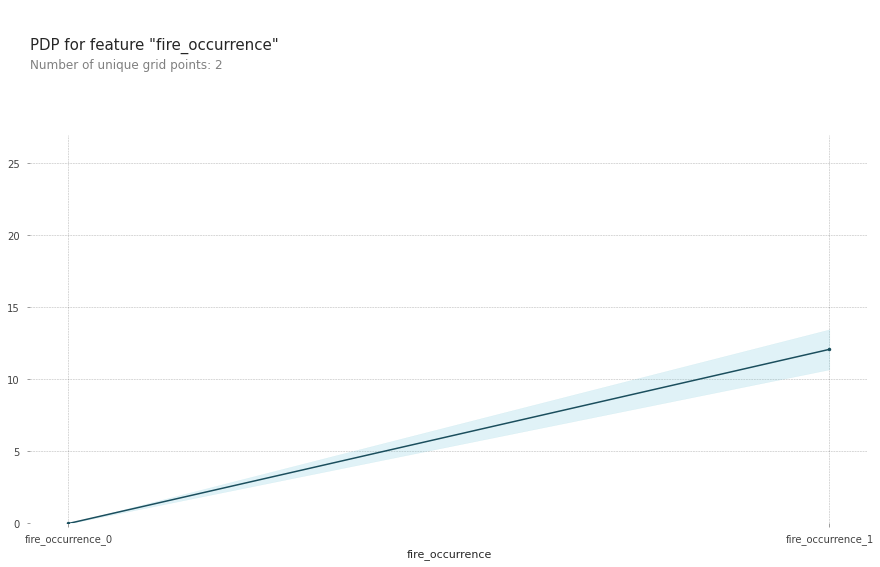

In [175]:
#Store Feature with Largest Impact as Indicated with Feature Importance
feat_feature = 'fire_occurrence'

#Calculate Impact of Feature
feat_isolate = pdp_isolate(
    xgb_model,
    dataset=X_val,
    model_features=X_val.columns,
    feature = feat_feature
)

#Plot Results
feat_plot_one = pdp_plot(feat_isolate, feature_name=feat_feature);

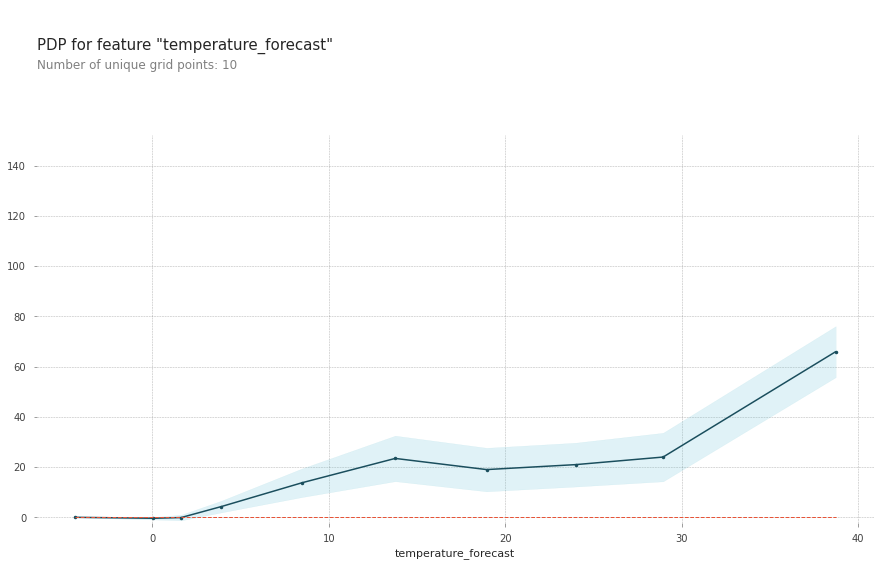

In [176]:
#Store Feature with Largest Impact as indicated with Permutation Importance
perm_feature = 'temperature_forecast'

#Calculate Impact of Feature
perm_isolate = pdp_isolate(
    xgb_model,
    dataset=X_val,
    model_features=X_val.columns,
    feature = perm_feature
)

#Plot Results
perm_plot_one = pdp_plot(perm_isolate, feature_name=perm_feature);

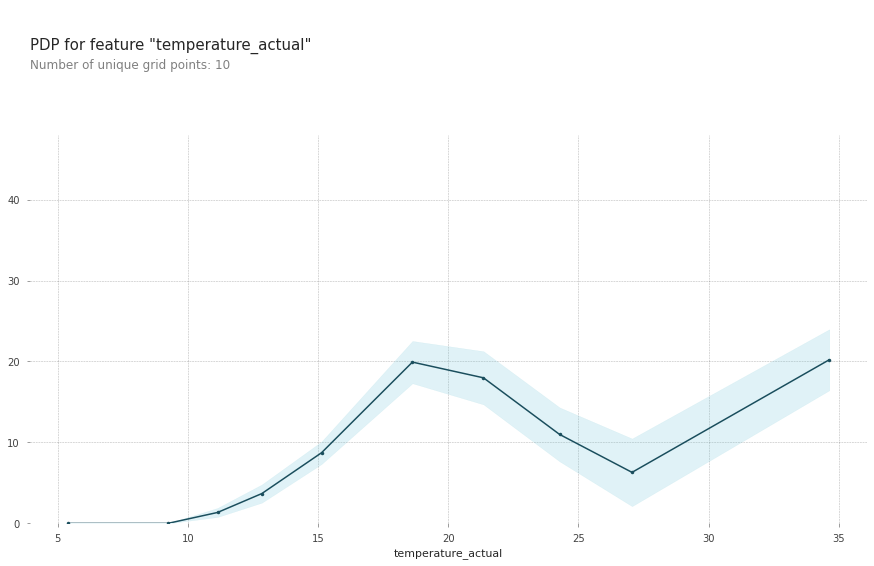

In [177]:
#Store Feature with Largest Impact as indicated with Permutation Importance
feature3 = 'temperature_actual'

#Calculate Impact of Feature
feat3_isolate = pdp_isolate(
    xgb_model,
    dataset=X_val,
    model_features=X_val.columns,
    feature = feature3
)

#Plot Results
feat3_plot_one = pdp_plot(feat3_isolate, feature_name=feature3);

###Two Feature Partial Dependance Plot

findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.


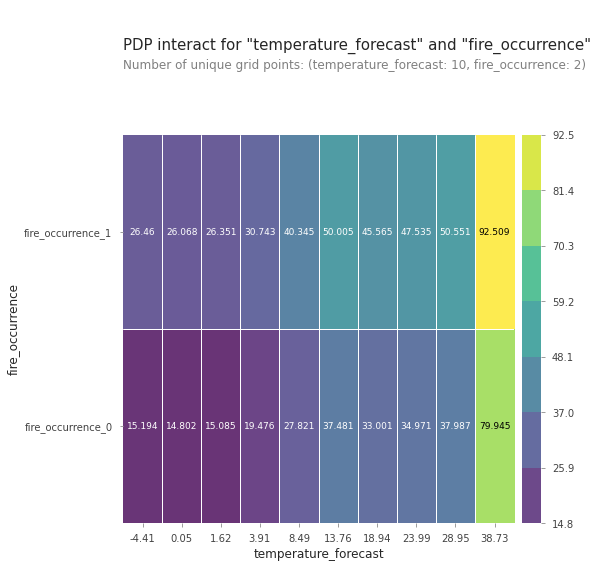

In [186]:
#Store the top Permutation Importance + the top Feature Importance
pdp1_features = [perm_feature, feat_feature]

#Calculate Interaction
pdp1_interact = pdp_interact(
    xgb_model,
    dataset = X_val,
    model_features = X_val.columns,
    features = pdp1_features,
)

#Plot Results
pdp1_interact_plot = pdp_interact_plot(
    pdp1_interact,
    plot_type='grid',
    feature_names = pdp1_features,
);

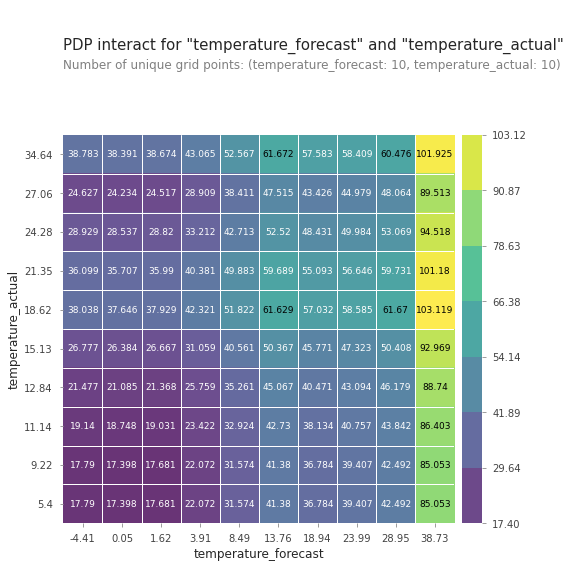

In [187]:
#Interaction Between Actual and Forecasted Temperatures
#Store the top Permutation Importance + the top Feature Importance
pdp2_features = [perm_feature, feature3]

#Calculate Interaction
pdp2_interact = pdp_interact(
    xgb_model,
    dataset = X_val,
    model_features = X_val.columns,
    features = pdp2_features,
)

#Plot Results
pdp2_interact_plot = pdp_interact_plot(
    pdp2_interact,
    plot_type='grid',
    feature_names = pdp2_features,
);

##Shapley Plots

###Build Shapley Friendly Data

In [190]:
#Shapley Data Adjustments - Manual Simple Imputer to Bypass Pipeline

#Copy Wildfires DataFrame
shap_df = NSW_wildfires.copy()

#Fill Wildfires DataFrame Column NaNs with Column Median Value
#To mimic xgb_model
fill_col_nans(shap_df, 'precipitation_forecast', 'median')
fill_col_nans(shap_df, 'relative_humidity_forecast', 'median')
fill_col_nans(shap_df, 'solar_radiation_forecast', 'median')
fill_col_nans(shap_df, 'temperature_forecast', 'median')
fill_col_nans(shap_df, 'wind_speed_forecast', 'median')
fill_col_nans(shap_df, 'precipitation_actual', 'median')
fill_col_nans(shap_df, 'relative_humidity_actual', 'median')
fill_col_nans(shap_df, 'solar_radiation_actual', 'median')
fill_col_nans(shap_df, 'temperature_actual', 'median')
fill_col_nans(shap_df, 'wind_speed_actual', 'median')

#Split Shapley Data
  #Assign Target, and CutOffs
shap_target = 'estimated_fire_area'
shap_cutoff_test = '2019-08-27'
shap_cutoff_val = '2018-07-11'

#Assign X, y variables
shap_y = shap_df[target]
shap_X = shap_df.drop(columns=target)

#Split Data Using Above Function
shap_X_train, shap_X_test, shap_X_val, shap_y_train, shap_y_test, shap_y_val = (
    train_test_val_drop_comask(
        shap_df, shap_target, shap_cutoff_test, shap_cutoff_val)
    )

In [191]:
nulls_before = shap_df.isnull().sum()
nulls_before

precipitation_forecast        0
relative_humidity_forecast    0
solar_radiation_forecast      0
temperature_forecast          0
wind_speed_forecast           0
precipitation_actual          0
relative_humidity_actual      0
solar_radiation_actual        0
temperature_actual            0
wind_speed_actual             0
soil_water_content_actual     4
estimated_fire_area           0
fire_occurrence               0
dtype: int64

In [192]:
nulls_after = shap_df.isnull().sum()
nulls_after

precipitation_forecast        0
relative_humidity_forecast    0
solar_radiation_forecast      0
temperature_forecast          0
wind_speed_forecast           0
precipitation_actual          0
relative_humidity_actual      0
solar_radiation_actual        0
temperature_actual            0
wind_speed_actual             0
soil_water_content_actual     4
estimated_fire_area           0
fire_occurrence               0
dtype: int64

###Build Shapley Friendly XGBoost Regressor Model
***NO PIPELINES***

In [193]:
#Copy of XGB Model
shap_xgb = XGBRegressor(
        objective='reg:squarederror',
        subsample=0.6,
        colsample_bylevel=0.1,
        colsample_bytree=0.4,
        max_depth=24,
        learning_rate=.02,
        n_estimators=125,
        min_child_weight=9,
        gamma=2,
        random_state=42,
        n_jobs=-1,
)

#Fit
%timeit shap_xgb.fit(shap_X_train, shap_y_train);

10 loops, best of 5: 160 ms per loop


In [194]:
#Shapley XGB Score
shap_xgb_train_score, shap_xgb_val_score = calc_model_score('Shapley XGBoost Regressor Model', 
                                          shap_xgb, shap_X_train, shap_y_train, 
                                          shap_X_val, shap_y_val)


  Shapley XGBoost Regressor Model Training Accuracy:  0.4940419620230576
  Shapley XGBoost Regressor Model Validation Accuracy:  -0.31382921483996906  
  


In [195]:
#Compare to Original
print(f'''
XGBoost Regressor Model Training Accuracy:  {xgb_train_score} 
XGBoost Regressor Model Validation Accuracy:  {xgb_val_score }
''')


XGBoost Regressor Model Training Accuracy:  0.4234177939755004 
XGBoost Regressor Model Validation Accuracy:  -1.1639994164685472



###Shapley Calculations

In [196]:
#Store DF of Single Validation Row 
shap_samples = shap_X_val.tail(1)
shap_samples

,precipitation_forecast,relative_humidity_forecast,solar_radiation_forecast,temperature_forecast,wind_speed_forecast,precipitation_actual,relative_humidity_actual,solar_radiation_actual,temperature_actual,wind_speed_actual,soil_water_content_actual,fire_occurrence
Date,,,,,,,,,,,,
2019-08-26,0.70387,179.47031,50.78887,0.81402,12.07129,0.29627,55.27054,15.55658,10.7884,2.88816,0.16005,1


In [197]:
#Create Explainer
explainer = shap.TreeExplainer(shap_xgb)
shap_value = explainer.shap_values(shap_samples)

In [203]:
#Initialize Java Script
shap.initjs()
shap_plot = shap.force_plot(
    base_value = explainer.expected_value,
    shap_values = shap_value,
    features = shap_samples,
)
shap_plot

In [199]:
shap_df = pd.DataFrame(data=shap_value[0], 
                       index=shap_X_val.columns, 
                       columns=['shap_value']
                       )

shap_df

,shap_value
precipitation_forecast,3.490088
relative_humidity_forecast,-4.028743
solar_radiation_forecast,2.735539
temperature_forecast,-2.805840
wind_speed_forecast,-0.117632
precipitation_actual,-0.543322
relative_humidity_actual,4.793216
solar_radiation_actual,6.988403
temperature_actual,-3.707561
wind_speed_actual,0.280476


In [200]:
#Create Waterfall Explainer
wf_explainer = shap.TreeExplainer(shap_xgb)
wf_shap_value = explainer(shap_samples)

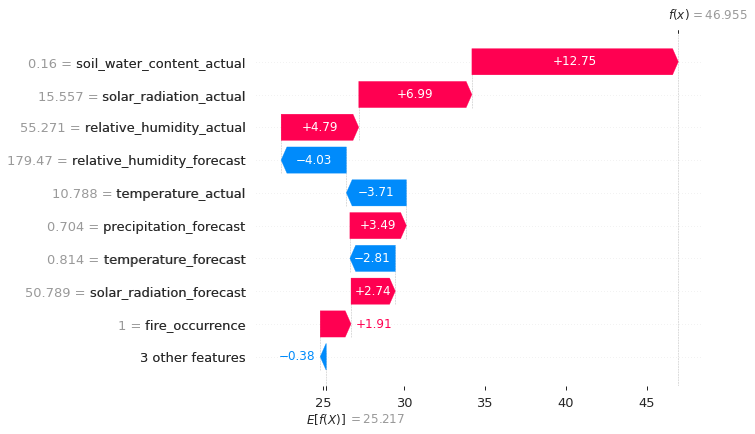

In [204]:
shap_wf = shap.plots.waterfall(wf_shap_value[0])
shap_wf

#6.   Visualizaions

In [167]:
lin_reg_plt

In [171]:
feat_imp_fig

In [172]:
perm_imp_fig

##PDP Plots

In [182]:
feat_plot_one = pdp_plot(feat_isolate, feature_name=feat_feature);

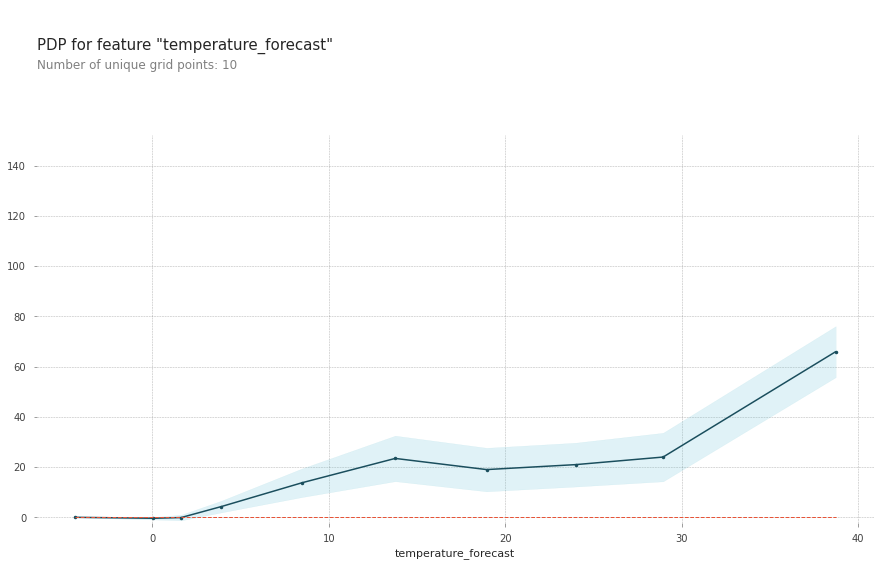

In [183]:
perm_plot_one = pdp_plot(perm_isolate, feature_name=perm_feature);

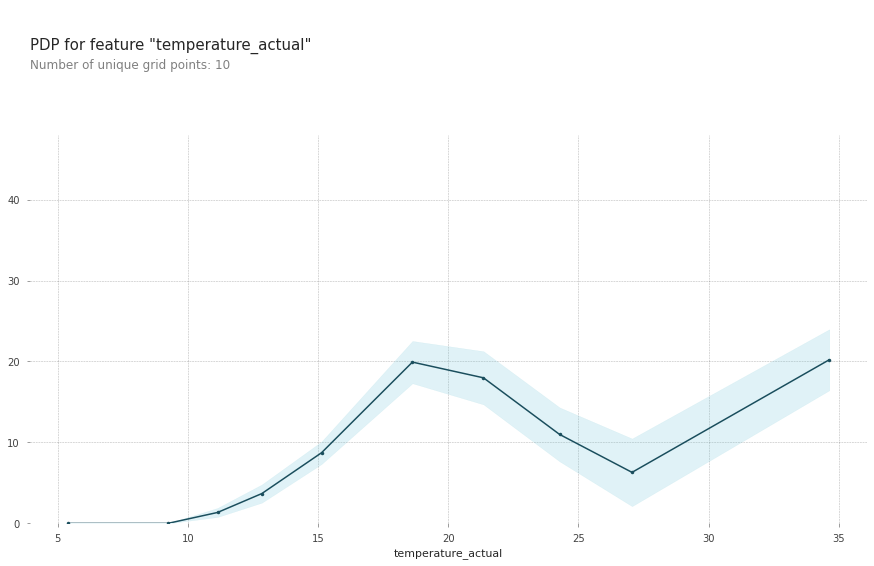

In [184]:
feat3_plot_one = pdp_plot(feat3_isolate, feature_name=feature3);

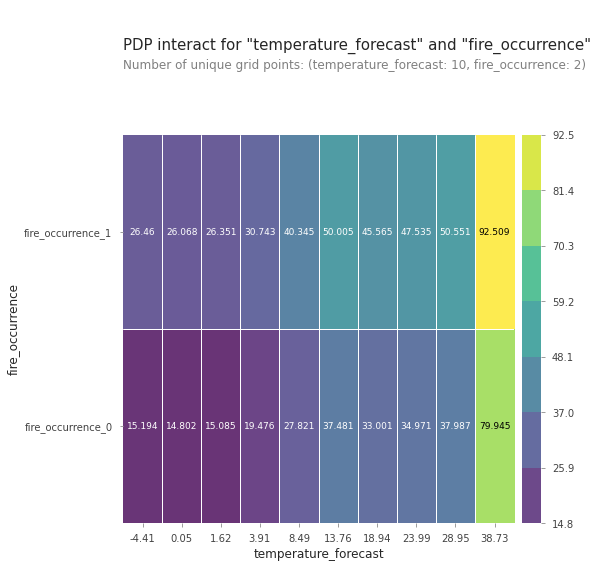

In [188]:
pdp1_interact_plot = pdp_interact_plot(
    pdp1_interact,
    plot_type='grid',
    feature_names = pdp1_features,
);

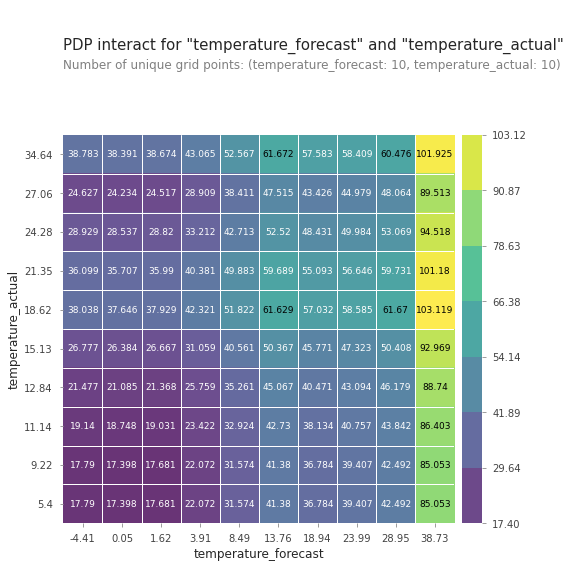

In [189]:
pdp2_interact_plot = pdp_interact_plot(
    pdp2_interact,
    plot_type='grid',
    feature_names = pdp2_features,
);

##Shapley Plots

In [208]:
shap.initjs()
shap_plot = shap.force_plot(
    base_value = explainer.expected_value,
    shap_values = shap_value,
    features = shap_samples,
)
shap_plot

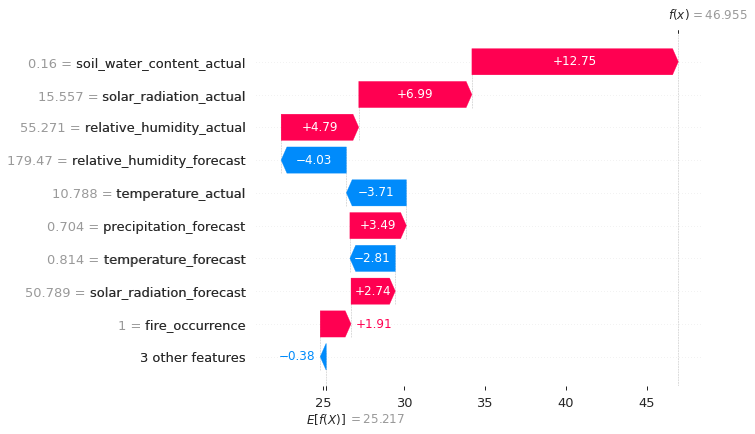

In [207]:
shap_wf = shap.plots.waterfall(wf_shap_value[0])
shap_wf